# Analysis of two real datasets with ScanOFC

In [40]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
from sklearn.metrics.cluster import contingency_matrix
from scanofc import FoldChanges, Clustering, NetworkInference
from scanofc_suppl_functions import (scale_data, reorder_clusters, joint_clustering_analysis, 
                                     compare_clusters, plot_cluster_venn_summary)
import warnings
warnings.filterwarnings('ignore')
mpl.style.use('seaborn')
mpl.rcParams['font.family'] = 'serif' 

## Step 1: Data extraction

In [2]:
### Data extraction: LINAC
trans_data_linac = pd.read_excel('Table_LINAC.xlsx')
trans_data_linac = trans_data_linac.where(trans_data_linac.loc[:,'Dose(Gy)']!=2)
trans_data_linac = trans_data_linac.dropna(axis=0, how='all').dropna(axis=1, how='any')
gene_names_linac = trans_data_linac.columns[5:]
nb_var_linac = len(gene_names_linac)
trans_measures_linac = trans_data_linac.values[:, 5:]
time_pts = trans_data_linac.values[:15:3, 3].astype(float)
timelen = len(time_pts)
dim_data = trans_measures_linac.shape
# Reshaping to fit the required format:
linac_data_reshaped = np.reshape(trans_measures_linac, (2, 3*timelen, dim_data[1]))
linac_data_reshaped = np.reshape(linac_data_reshaped, (2, timelen, 3, dim_data[1]))
linac_log2_data = np.log2(linac_data_reshaped.transpose((1,0,2,3)).astype(float))

### Data extraction: SARRP
trans_data_sarrp = pd.read_excel('Table_SARRP.xlsx')
trans_data_sarrp = trans_data_sarrp.where(trans_data_sarrp.loc[:,'Dose(Gy)']!=2)
trans_data_sarrp = trans_data_sarrp.dropna(axis=0, how='all').dropna(axis=1, how='any')
gene_names_sarrp = trans_data_sarrp.columns[4:]
nb_var_sarrp = len(gene_names_sarrp)
# Fixing missing replicates (filling with NaNs):
trans_data_sarrp = pd.concat((trans_data_sarrp, trans_data_sarrp.loc[(2, 17, 40),:]))
trans_data_sarrp.sort_index(inplace=True)
trans_data_sarrp.reset_index(inplace=True)
trans_data_sarrp.drop('index', axis=1, inplace=True)
trans_data_sarrp.iloc[3, 4:] = np.nan
trans_data_sarrp.iloc[19, 4:] = np.nan
trans_data_sarrp.iloc[23, 4:] = np.nan
trans_measures_sarrp = trans_data_sarrp.values[:, 4:]
dim_data_sarrp = trans_measures_sarrp.shape
# Reshaping to fit the required format:
sarrp_data_reshaped = np.reshape(trans_measures_sarrp, (2, 4*timelen, dim_data_sarrp[1]))
sarrp_data_reshaped = np.reshape(sarrp_data_reshaped, (2, timelen, 4, dim_data_sarrp[1]))
sarrp_log2_data = np.log2(sarrp_data_reshaped.transpose((1,0,2,3)).astype(float))

# Identifying genes present in both datasets for comparison:
(common_genes, 
 common_indices_linac, 
 common_indices_sarrp) = np.intersect1d(gene_names_linac, gene_names_sarrp, return_indices=True)

In [3]:
trans_data_sarrp = pd.read_excel('Table_SARRP.xlsx')
trans_data_sarrp = trans_data_sarrp.where(trans_data_sarrp.loc[:,'Dose(Gy)']!=2)
trans_data_sarrp = trans_data_sarrp.dropna(axis=0, how='all').dropna(axis=1, how='any')
gene_names_sarrp = trans_data_sarrp.columns[4:]
nb_var_sarrp = len(gene_names_sarrp)

## Step 2: Fold Changes Estimation & Scaling

In [4]:
### Defining unsclaled fold changes:
fc_basic_linac = FoldChanges(data=linac_log2_data, var_names=gene_names_linac, time_points=time_pts)
fc_means_linac = fc_basic_linac.means
fc_sd_linac = np.sqrt(np.diagonal(fc_basic_linac.cov, axis1=1, axis2=2))
fc_basic_sarrp = FoldChanges(data=sarrp_log2_data, var_names=gene_names_sarrp, time_points=time_pts)
fc_means_sarrp = fc_basic_sarrp.means
fc_sd_sarrp = np.sqrt(np.diagonal(fc_basic_sarrp.cov, axis1=1, axis2=2))
### Defining sclaled fold changes:
linac_log2_data_doublenorm = scale_data(linac_log2_data, fc_basic_linac)
sarrp_log2_data_doublenorm = scale_data(sarrp_log2_data, fc_basic_sarrp)

## Step 3: Fold Changes Clustering & Alignment

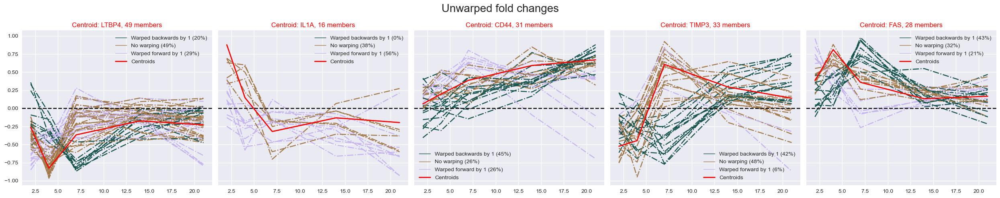

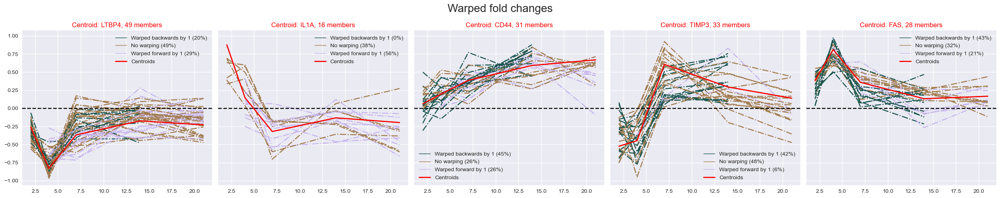

In [7]:
### Clustering & Alignment of LINAC data:
random_gen=np.random.RandomState(1)
max_warp_step = 1
pen_param_linac = 0.075
nb_blocks = 5
cl_linac = Clustering(data=linac_log2_data_doublenorm, var_names=gene_names_linac, time_points=time_pts, 
                      dist='d2hat', time_warp=True, max_warp_step=max_warp_step, sign_pen=True,
                      pen_param=pen_param_linac, random_gen=random_gen)
### Clustering with d2hat k-medoids:
(k_clusters_linac,
 k_centroids_linac,
 k_warps_linac,
 k_costs_linac) = cl_linac.fc_clustering(nb_blocks, nb_rep=2000, nb_best=100)
comp_cost_linac = cl_linac.calculate_comparable_cost(nb_blocks, k_clusters_linac)

cl_linac.plot_clusters(nb_blocks, k_clusters_linac, k_centroids_linac, 
                       warps=k_warps_linac, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

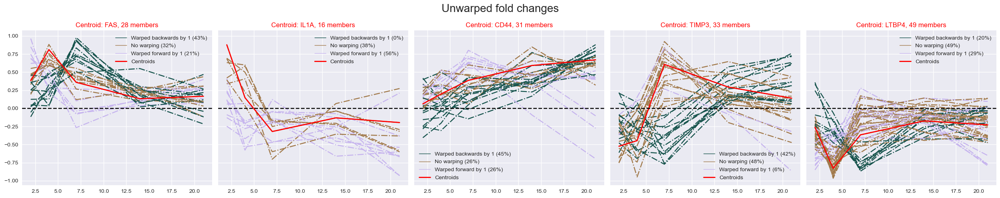

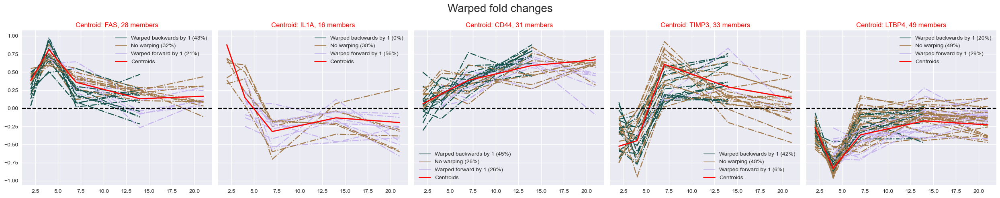

In [8]:
### Reorder clusters for convenience:
(fc_clusters_linac_no,
 fc_centroids_linac_no) = reorder_clusters((4,1,2,3,0), k_clusters_linac, k_centroids_linac)
cl_linac.plot_clusters(nb_blocks, fc_clusters_linac_no, fc_centroids_linac_no, 
                       warps=k_warps_linac, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

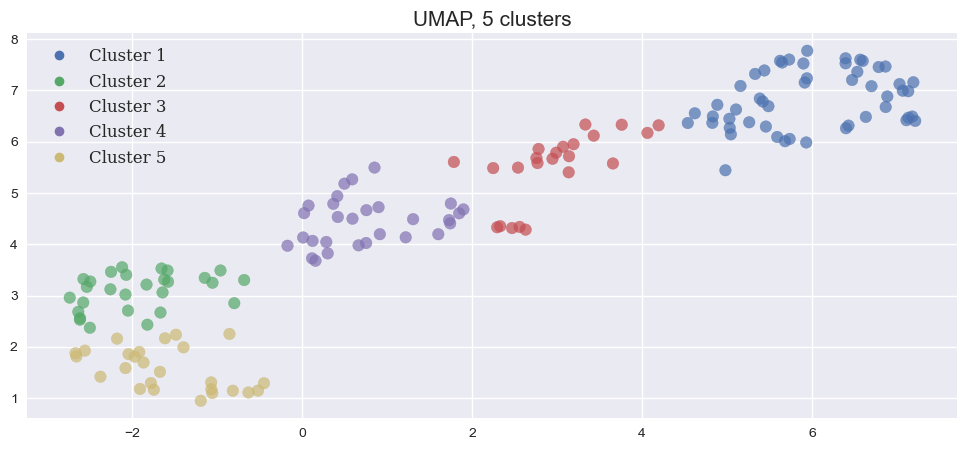

In [9]:
### Clustering with d2hat UMAP:
(umap_clusters_linac,
 umap_centroids_linac,
 umap_warps_linac) = cl_linac.fc_clustering(nb_blocks, nb_rep=2000, method='umap', disp_plot=True)
umap_comp_cost_linac = cl_linac.calculate_comparable_cost(nb_blocks, umap_clusters_linac)

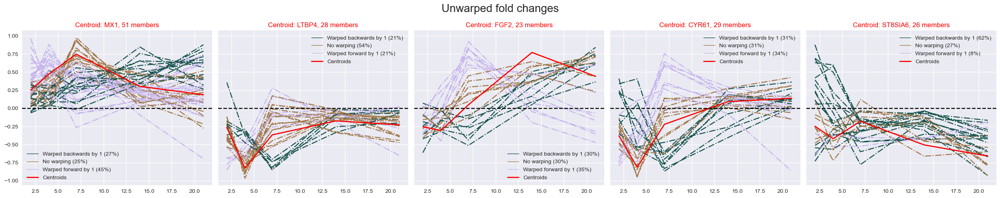

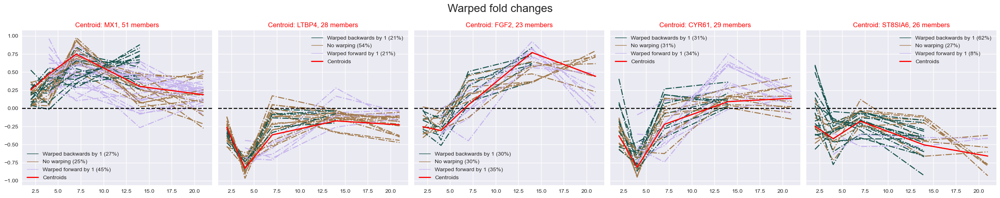

In [10]:
cl_linac.plot_clusters(nb_blocks, umap_clusters_linac, umap_centroids_linac, 
                       warps=umap_warps_linac, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

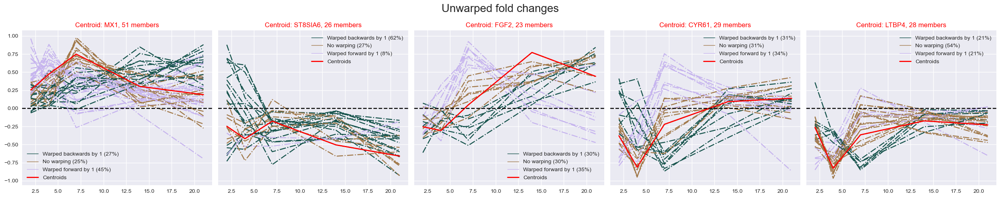

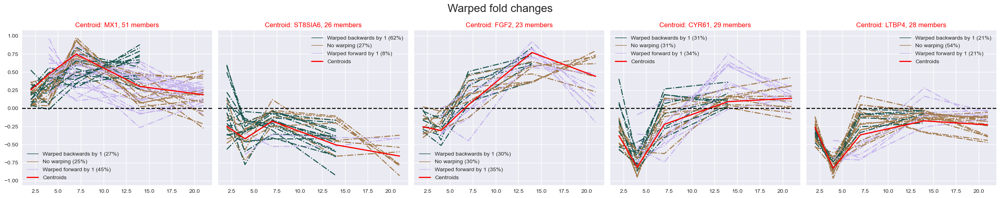

In [11]:
### Reorder clusters for convenience:
no_umap_linac = (0,4,2,3,1)
(umap_clusters_linac_no,
 umap_centroids_linac_no) = reorder_clusters(no_umap_linac, umap_clusters_linac, umap_centroids_linac)
cl_linac.plot_clusters(nb_blocks, umap_clusters_linac_no, umap_centroids_linac_no,
                       warps=umap_warps_linac, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

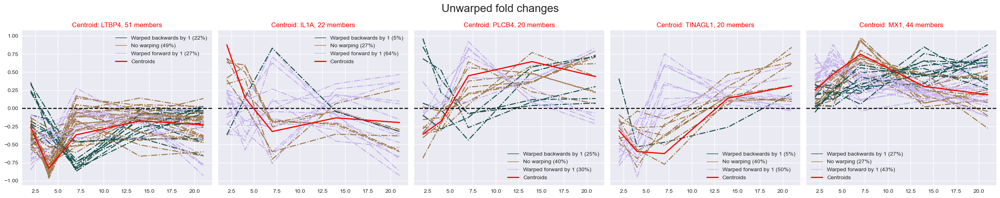

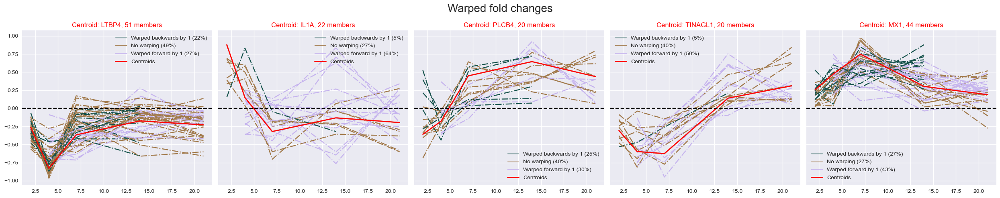

In [12]:
sparsity_sbm_linac = 0.75

### Computing LINAC network for SBM inference:
net_linac_sbm = NetworkInference(data=linac_log2_data_doublenorm, var_names=gene_names_linac, 
                                 time_points=time_pts, dist='d2hat', time_warp=True, 
                                 max_warp_step=max_warp_step, sign_pen=True, pen_param=pen_param_linac, 
                                 sparsity=sparsity_sbm_linac, directed=False)
### Clustering with d2hat SBM:
(sbm_linac,
 sbm_centroids_linac,
 sbm_comp_cost_linac) = net_linac_sbm.infer_sbm(nb_blocks, k_clusters_linac, n_init=500, verbosity=0, 
                                                pi_weight=0.8, n_iter_early_stop=100, random_gen=random_gen)
sbm_clusters_linac = sbm_linac.labels
corresp_centr = sbm_centroids_linac[sbm_clusters_linac]
sbm_warps_linac = cl_linac.optimal_warp_mat[np.arange(0,nb_var_linac), corresp_centr]
cl_linac.plot_clusters(nb_blocks, sbm_clusters_linac, sbm_centroids_linac,
                       warps=sbm_warps_linac, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

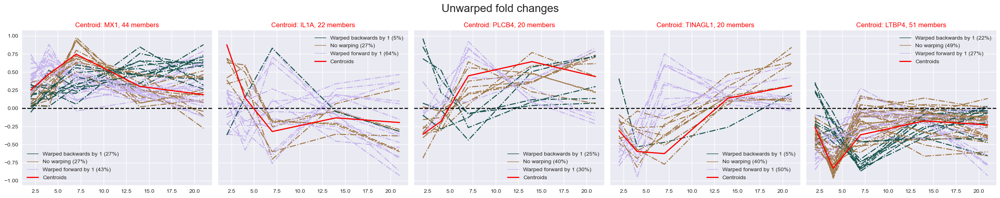

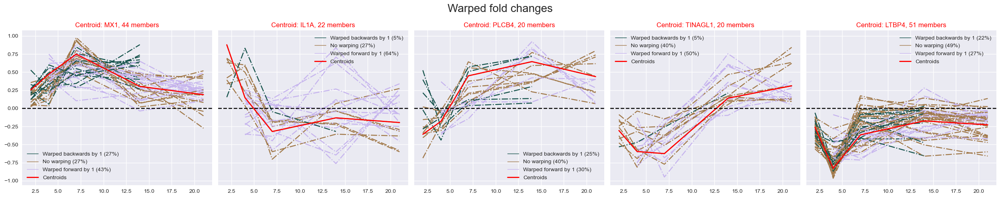

In [13]:
### Reorder clusters for convenience:
(sbm_clusters_linac_no,
 sbm_centroids_linac_no) = reorder_clusters((4,1,2,3,0), sbm_clusters_linac, sbm_centroids_linac)
cl_linac.plot_clusters(nb_blocks, sbm_clusters_linac_no, sbm_centroids_linac_no, 
                       warps=sbm_warps_linac, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

In [14]:
##### Analysis of the results based on 3 methods #####
jca_linac = joint_clustering_analysis(fc_clusters_linac_no, sbm_clusters_linac_no, umap_clusters_linac_no, 
                                      gene_names_linac, print_result=True)

Cluster 1: 
Order 1: 
ACTA2   ANXA4   C12orf5   CDKN1A   CEACAM1   CSF2   CSF3   CTSB   FAS   FDXR   GPX1   IKBIP   LTBP1   LYVE1   MFGE8   MX1   PIDD   PLA2G4C   PLA2G5   PLXNB1   SLIT3   TNFSF15   TP53I3
Order 2:
BCL2L1   GDF15   ITGAV   NFKBIZ
Order 3:
GNPTAB


Cluster 2: 
Order 1: 
ANGPT2   BBC3   BDKRB2   CDH5   ICAM1   IL1A   ITGA2   MAN2A1   PDE4D   PTGS2
Order 2:
AKAP12   EDIL3   EPHB1   HIF1A   ST8SIA6
Order 3:
CXCL2


Cluster 3: 
Order 1: 
B3GNT2   FGF2   FUT8   TBXAS1   TGFBR1
Order 2:
LMNA   TPM2   UCHL1   VTN
Order 3:
ADRB2   ANGPTL4   CCL5   CD44   COL4A1   CXCL11   EPHA5   FUCA1   GADD45A   GALNT12   GSN   IL12A   IL1RL1   IL8   ISG15   ITGA4   PLCD1   PLXNA3   PLXNB3   SERPINE1   SNAI2   TAGLN


Cluster 4: 
Order 1: 
COL12A1   CTSD   FBLN1   FST   G6PD   LRR1   LRRC17   PPP4C   TIMP3   TINAGL1   TXNDC5   VCAM1
Order 2:
A2M   CAP1   CDKN2A   FN1   HMOX1   KDR   KRT18   MSN   MYH9   ROR1
Order 3:
CCL2   HSPG2   IL6   ITGB3   KIT   LTB   PLCB2   PLCB4   RELA   SELE   UAP1


In [15]:
### Clustering & Alignment of SARRP data:
random_gen=np.random.RandomState(1) # reset the seed
pen_param_sarrp=0.1
cl_sarrp = Clustering(data=sarrp_log2_data_doublenorm, var_names=gene_names_sarrp, time_points=time_pts, 
                      dist='d2hat', time_warp=True, max_warp_step=max_warp_step, sign_pen=True,
                      pen_param=pen_param_sarrp, random_gen=random_gen)
### Clustering with d2hat k-medoids:
(k_clusters_sarrp,
 k_centroids_sarrp,
 k_warps_sarrp,
 k_costs_sarrp) = cl_sarrp.fc_clustering(nb_blocks, nb_rep=2000, disp_plot=True, nb_best=100)
comp_cost_sarrp = cl_sarrp.calculate_comparable_cost(nb_blocks, k_clusters_sarrp)

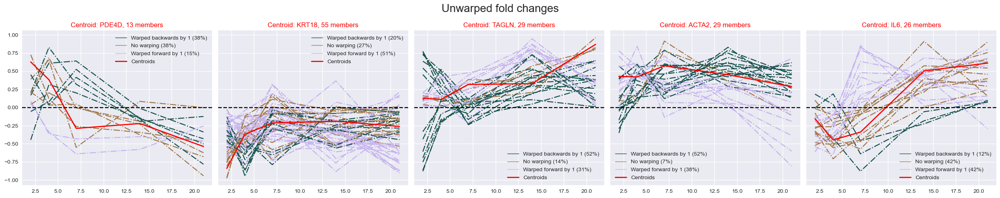

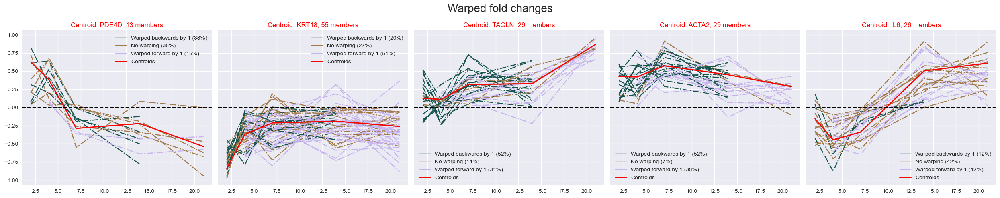

In [16]:
cl_sarrp.plot_clusters(nb_blocks, k_clusters_sarrp, k_centroids_sarrp, warps=k_warps_sarrp, 
                       nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

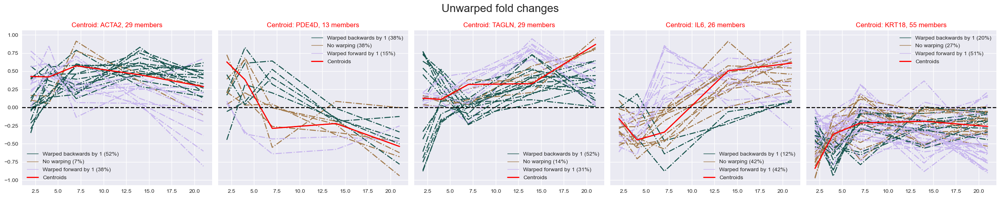

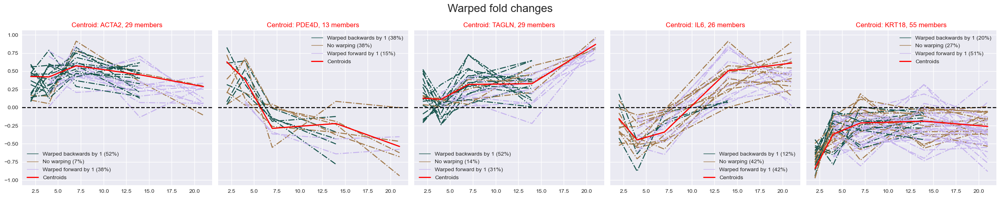

In [17]:
### Reorder clusters for convenience:
(fc_clusters_sarrp_no,
 fc_centroids_sarrp_no) = reorder_clusters((3,0,2,4,1), k_clusters_sarrp, k_centroids_sarrp)
cl_sarrp.plot_clusters(nb_blocks, fc_clusters_sarrp_no, fc_centroids_sarrp_no, warps=k_warps_sarrp, 
                       nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

In [18]:
### Compare LINAC and SARRP cluster distributions (matching corresponding behaviour types):
contingency_matrix(fc_clusters_linac_no[common_indices_linac], fc_clusters_sarrp_no[common_indices_sarrp])

array([[13,  4,  7,  2,  0],
       [ 1,  4,  4,  2,  4],
       [11,  0, 14,  2,  2],
       [ 3,  4,  2, 11, 11],
       [ 0,  1,  1,  8, 38]])

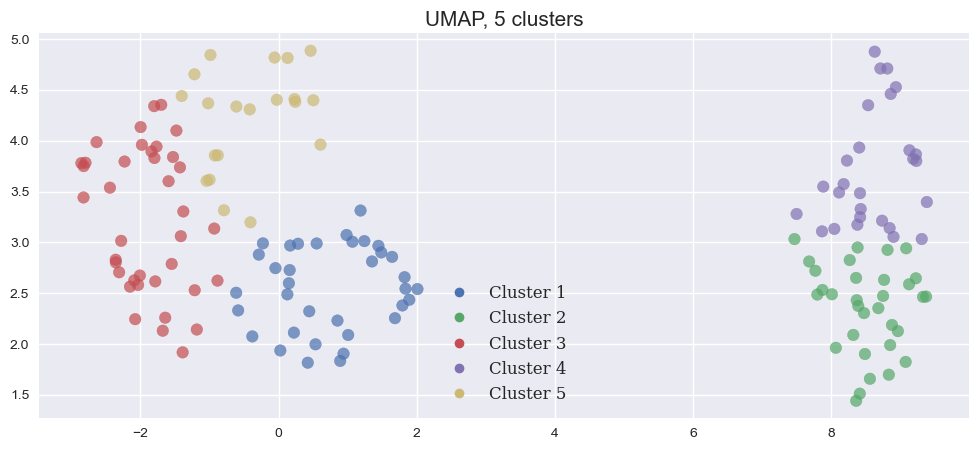

In [19]:
### Clustering with d2hat UMAP:
(umap_clusters_sarrp,
 umap_centroids_sarrp,
 umap_warps_sarrp) = cl_sarrp.fc_clustering(nb_blocks, nb_rep=2000, method='umap', disp_plot=True)
umap_comp_cost_sarrp = cl_sarrp.calculate_comparable_cost(nb_blocks, umap_clusters_sarrp)

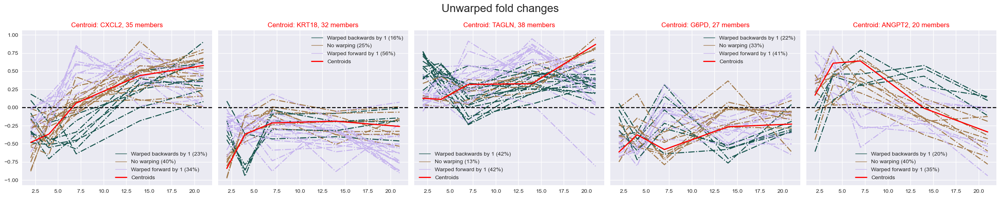

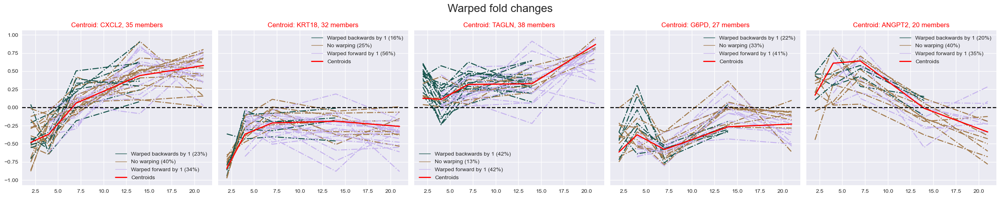

In [20]:
cl_sarrp.plot_clusters(nb_blocks, umap_clusters_sarrp, umap_centroids_sarrp, warps=umap_warps_sarrp, 
                       nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

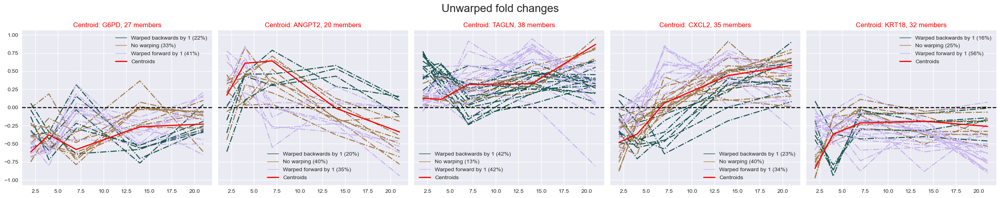

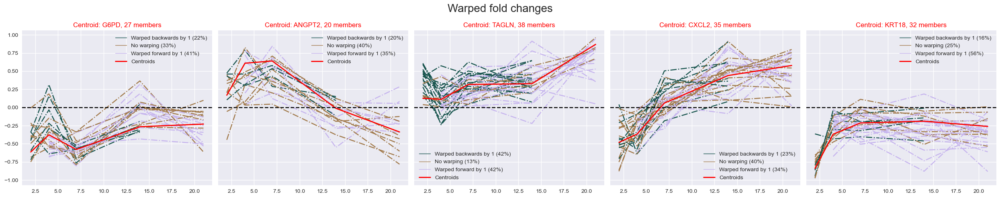

In [21]:
### Reorder clusters for convenience:
no_umap_sarrp = (3,4,2,0,1)
(umap_clusters_sarrp_no,
 umap_centroids_sarrp_no) = reorder_clusters(no_umap_sarrp, umap_clusters_sarrp, umap_centroids_sarrp)
cl_sarrp.plot_clusters(nb_blocks, umap_clusters_sarrp_no, umap_centroids_sarrp_no,
                       warps=umap_warps_sarrp, nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

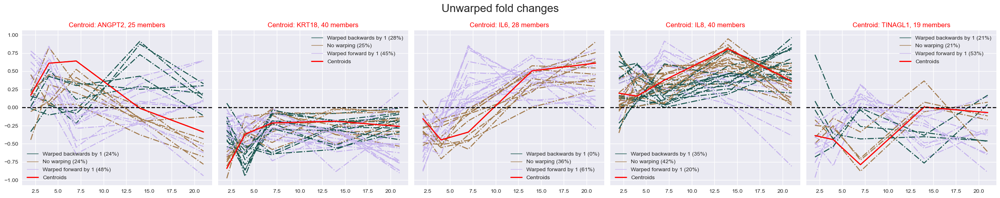

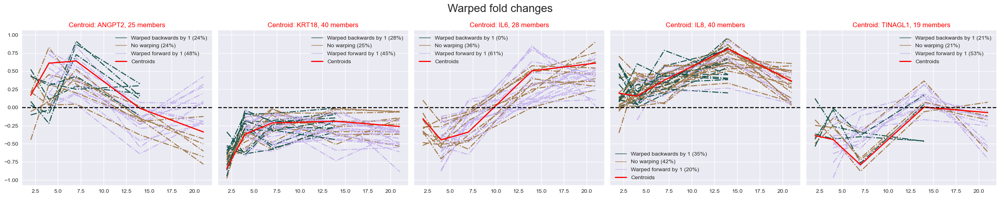

In [22]:
sparsity_sbm_sarrp = 0.8

### Computing sarrp network for SBM inference:
net_sarrp_sbm = NetworkInference(data=sarrp_log2_data_doublenorm, var_names=gene_names_sarrp, 
                                 time_points=time_pts, dist='d2hat', time_warp=True,
                                 max_warp_step=max_warp_step, sign_pen=True, pen_param=pen_param_sarrp, 
                                 sparsity=sparsity_sbm_sarrp, directed=False)
### Clustering with d2hat SBM:
(sbm_sarrp,
 sbm_centroids_sarrp,
 sbm_comp_cost_sarrp) = net_sarrp_sbm.infer_sbm(nb_blocks, k_clusters_sarrp, n_init=500, verbosity=0, 
                                                pi_weight=0.8, n_iter_early_stop=100, random_gen=random_gen)
sbm_clusters_sarrp = sbm_sarrp.labels
corresp_centr = sbm_centroids_sarrp[sbm_clusters_sarrp]
sbm_warps_sarrp = cl_sarrp.optimal_warp_mat[np.arange(0,nb_var_sarrp), corresp_centr]
cl_sarrp.plot_clusters(nb_blocks, sbm_clusters_sarrp, sbm_centroids_sarrp, warps=sbm_warps_sarrp, 
                       nb_cols=nb_blocks, nb_rows=1, figsize=(25,5))

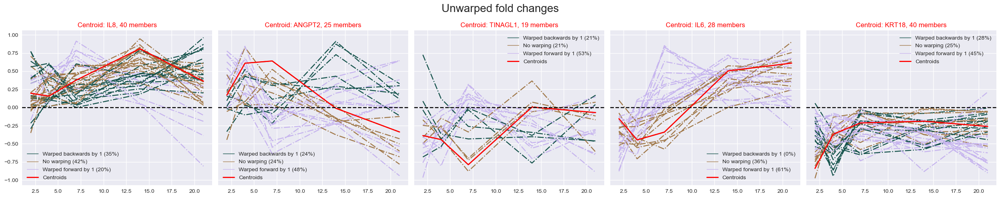

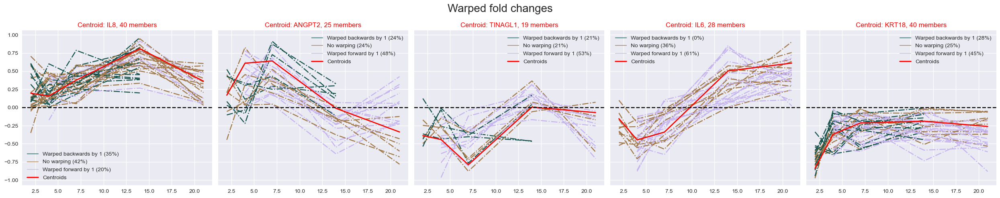

In [23]:
### Reorder clusters for convenience:
(sbm_clusters_sarrp_no,
 sbm_centroids_sarrp_no) = reorder_clusters((3,0,4,2,1),
                                             sbm_clusters_sarrp,
                                             sbm_centroids_sarrp)
cl_sarrp.plot_clusters(nb_blocks, sbm_clusters_sarrp_no, sbm_centroids_sarrp_no,
                        warps=sbm_warps_sarrp, nb_cols=nb_blocks, nb_rows=1,
                        figsize=(25,5))

In [24]:
##### Analysis of the results based on 3 methods #####
jca_sarrp = joint_clustering_analysis(fc_clusters_sarrp_no, sbm_clusters_sarrp_no, umap_clusters_sarrp_no, 
                                      gene_names_sarrp, print_result=True)

Cluster 1: 
Order 1: 

Order 2:
A2M   ACTA2   CD44   CDKN1A   COL4A1   CXCL11   EPHA5   FAS   FDXR   GNPTAB   GPX1   HEY2   ISG15   ITGA4   ITGAV   ITGB3   LYVE1   NFKBIZ   PLA2G4C   PLXNB3   SELE   TP53I3   TPM2   UCHL1
Order 3:
IKBIP   ITGA2   PIDD   PLCD1   SNAI2


Cluster 2: 
Order 1: 
ANGPT2   BCL2L1   CEACAM1   EPHB1   KDR   KIT   MFGE8   PDE4D   PLCB2   PLXNB1
Order 2:
BBC3
Order 3:
HMOX1   PDGFA


Cluster 3: 
Order 1: 

Order 2:
ADRB2   AKAP12   ANGPTL4   ANXA4   C12orf5   CTSB   FUCA1   GADD45A   GALNT12   GCNT4   GDF15   GSN   IL12A   IL1A   IL1RL1   IL8   MX1   PLXNA3   PTGS2   TAGLN   TGFBR1   TNFSF15
Order 3:
B3GNT2   CDKN2A   CTGF   LTBP1   MAN2A1   PPP4C   TBXAS1


Cluster 4: 
Order 1: 
ANGPT1   BIRC3   CCL2   CD34   COL12A1   CTSD   CXCL2   CYR61   FGF2   GFRA1   ICAM1   IL6   LRRC17   MYH9   PLCB4   PMAIP1   SERPINE1   SLIT3   SOD2   TIMP3   UAP1   VCAM1
Order 2:
BMPR1B   CSF3
Order 3:
CAP1   DDR2


Cluster 5: 
Order 1: 
ALDH1A1   B4GALT5   BGN   CASP4   CDH5   CDK1   

In [25]:
##### Compare_clusters: LINAC vs SARRP
compclust_1 = compare_clusters(fc_clusters_linac_no[common_indices_linac], 
                               fc_clusters_sarrp_no[common_indices_sarrp], 
                               common_genes, print_result=True)

Cluster 1:
Common:
ACTA2   CDKN1A   FAS   FDXR   GNPTAB   GPX1   IKBIP   ITGAV   LYVE1   NFKBIZ   PIDD   PLA2G4C   TP53I3
Condition 1
ANXA4   BCL2L1   C12orf5   CEACAM1   CSF3   CTSB   GDF15   LTBP1   MFGE8   MX1   PLXNB1   SLIT3   TNFSF15
Condition 2
A2M   CD44   COL4A1   CXCL11   EPHA5   ISG15   ITGA2   ITGA4   ITGB3   PLCD1   PLXNB3   SELE   SNAI2   TPM2   UCHL1


Cluster 2:
Common:
ANGPT2   BBC3   EPHB1   PDE4D
Condition 1
AKAP12   CDH5   CXCL2   EDIL3   HIF1A   ICAM1   IL1A   ITGA2   MAN2A1   PTGS2   ST8SIA6
Condition 2
BCL2L1   CEACAM1   HMOX1   KDR   KIT   MFGE8   PDGFA   PLCB2   PLXNB1


Cluster 3:
Common:
ADRB2   ANGPTL4   B3GNT2   FUCA1   GADD45A   GALNT12   GSN   IL12A   IL1RL1   IL8   PLXNA3   TAGLN   TBXAS1   TGFBR1
Condition 1
CD44   COL4A1   CXCL11   EPHA5   FGF2   FUT8   ISG15   ITGA4   LMNA   PLCD1   PLXNB3   SERPINE1   SNAI2   TPM2   UCHL1
Condition 2
AKAP12   ANXA4   C12orf5   CDKN2A   CTGF   CTSB   GDF15   IL1A   LTBP1   MAN2A1   MX1   PPP4C   PTGS2   TNFSF15


Clus

We can generate Venn diagrams to visualize clusterings of two datasets while taking into account three different methods:

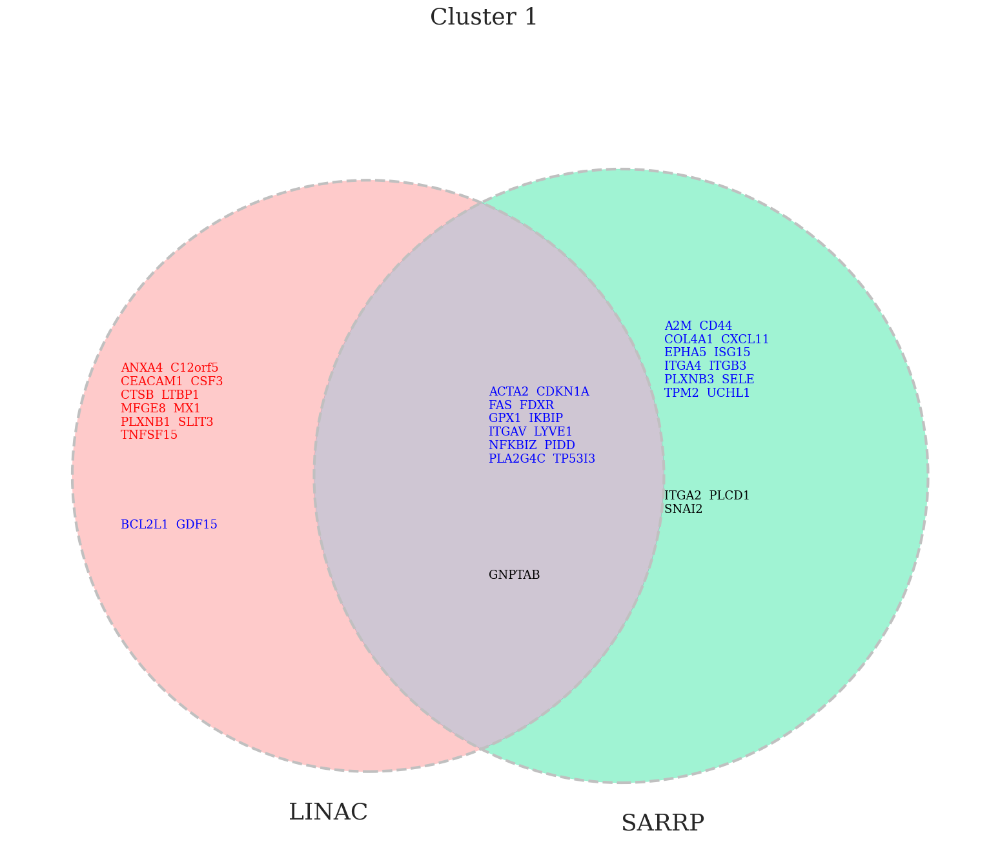

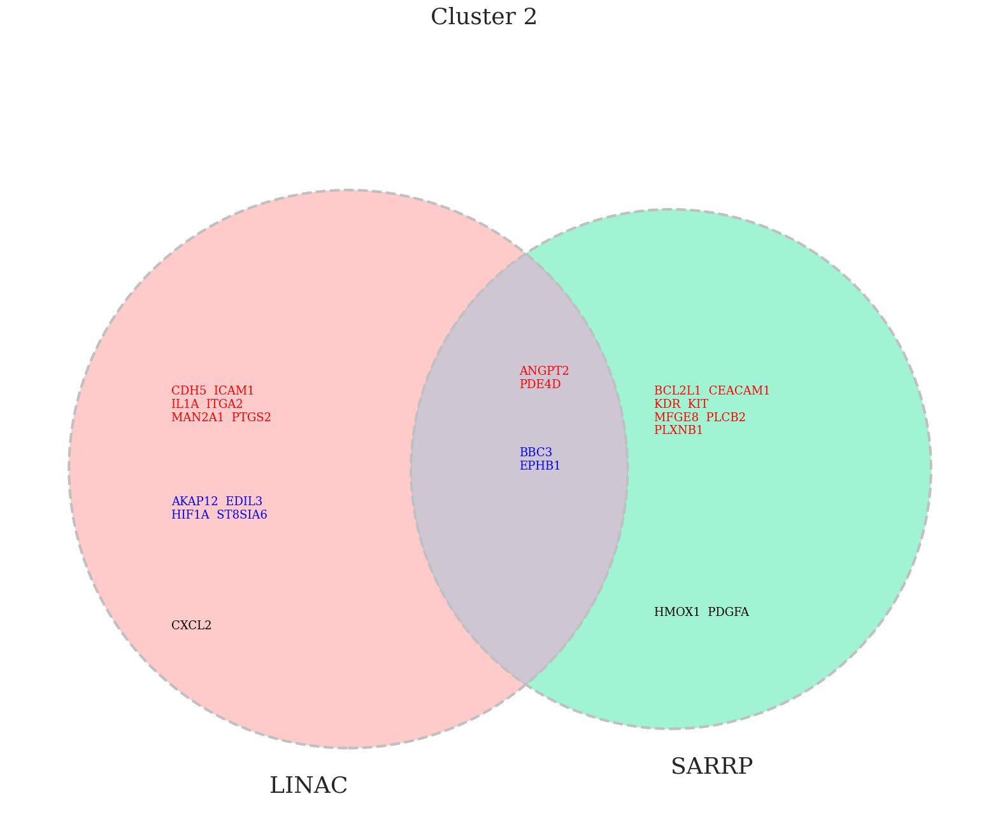

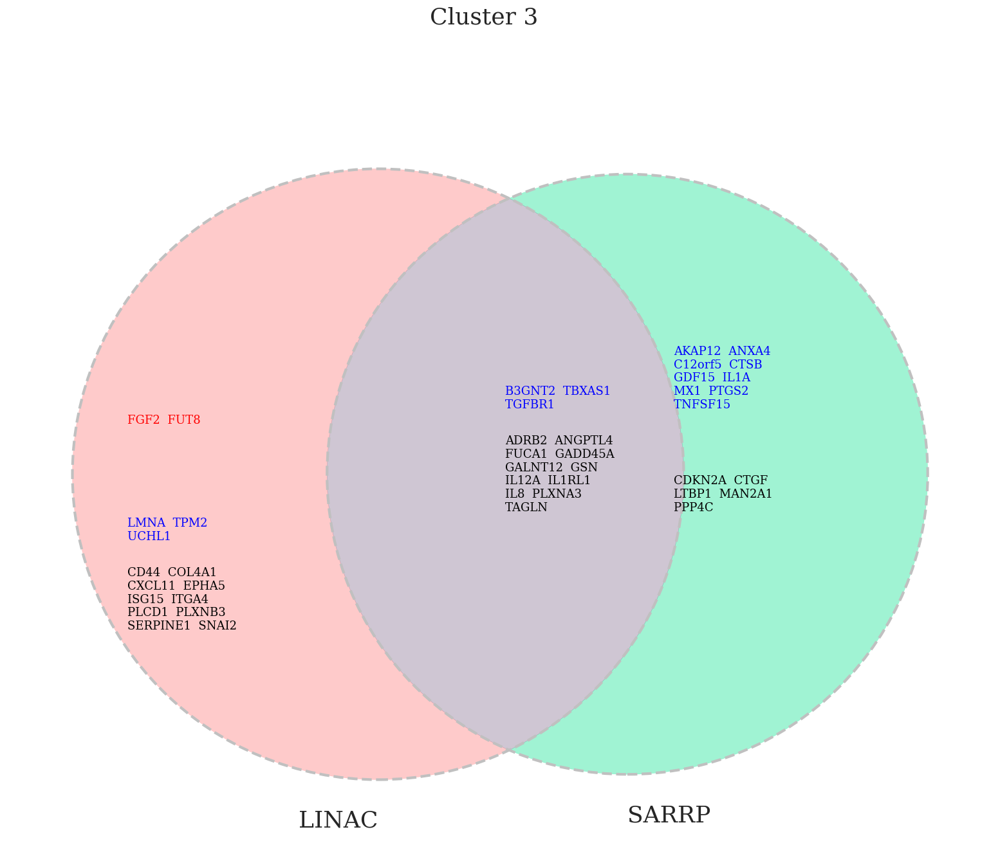

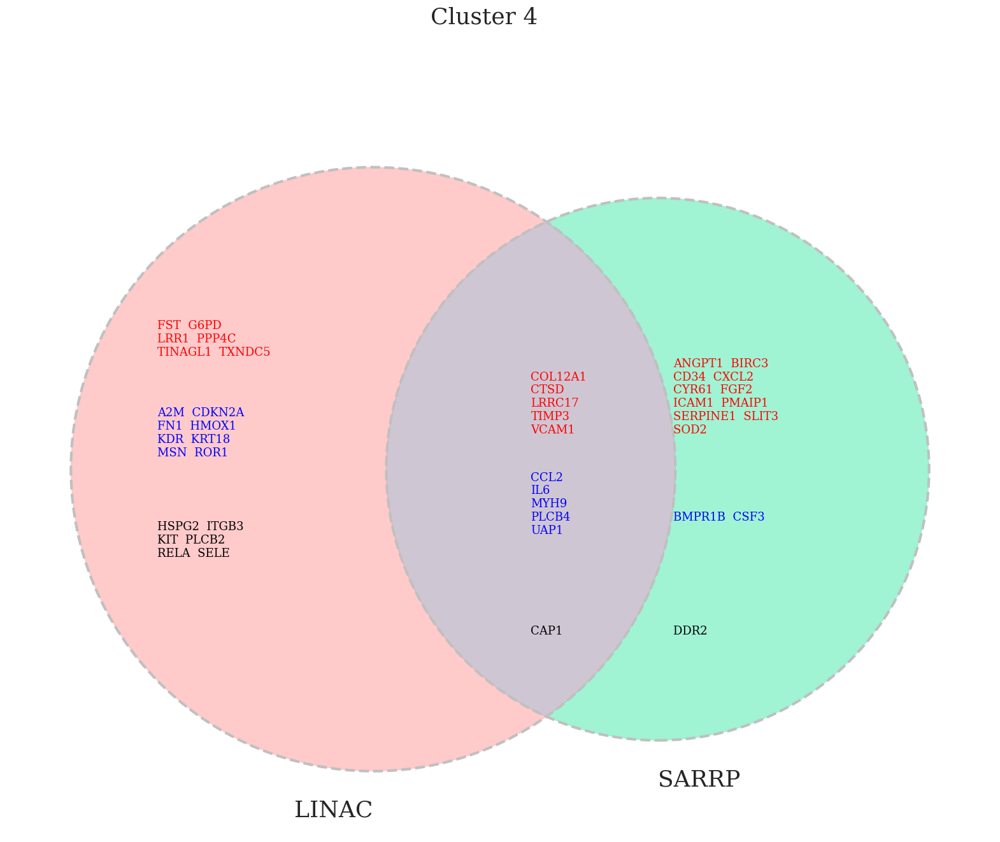

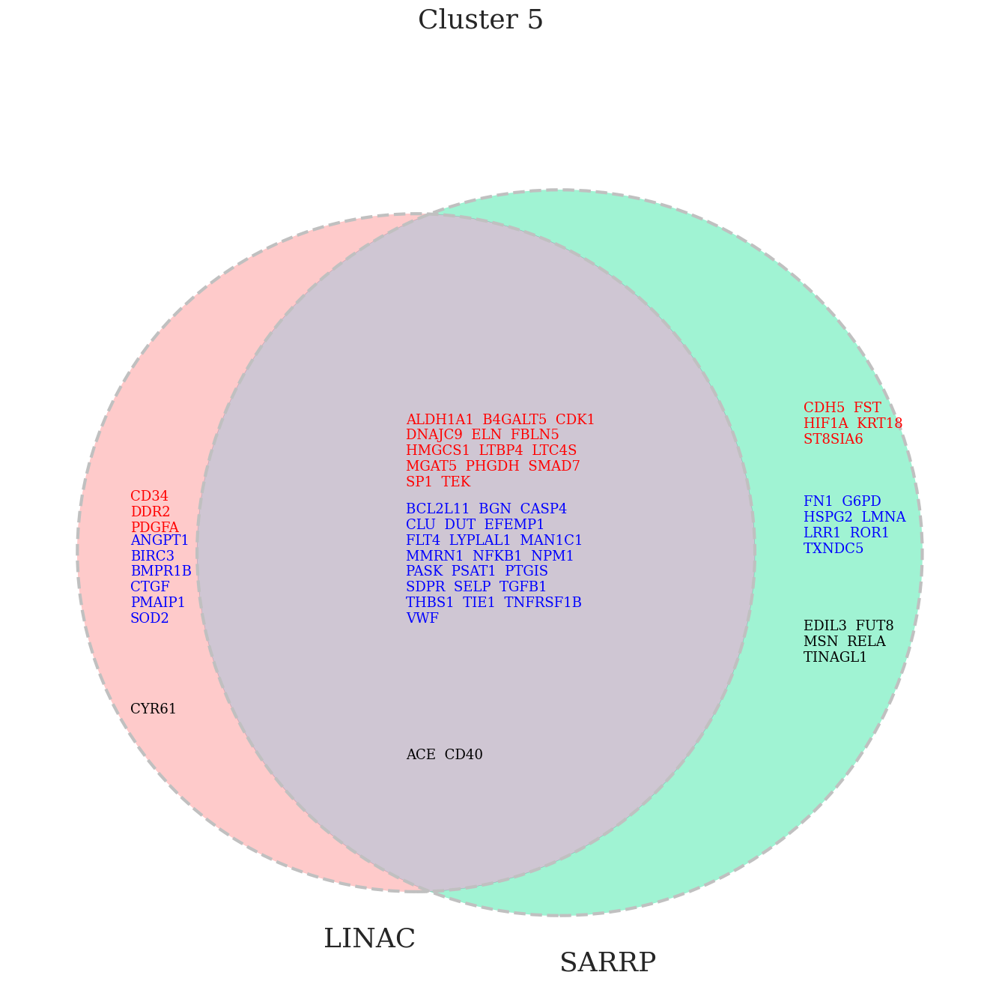

In [26]:
plot_cluster_venn_summary(jca_linac, jca_sarrp, compclust_1, condlabel_1='LINAC', condlabel_2='SARRP',
                          fontsize=13, figsize=(20, 15))

## Step 4: Fold Changes Network Inference

Cluster 1: FAS
Most connected members within cluster:
['CDKN1A', 'CEACAM1', 'TNFSF15', 'PIDD', 'PLXNB1', 'C12orf5', 'FAS', 'PLA2G4C', 'FDXR', 'GPX1']
Cluster 2: IL1A
Most connected members within cluster:
['BDKRB2', 'CXCL2', 'ANGPT2', 'IL1A', 'ITGA2', 'PDE4D', 'HIF1A', 'CDH5', 'ST8SIA6', 'EPHB1']
Cluster 3: CD44
Most connected members within cluster:
['IL12A', 'PLXNA3', 'SNAI2', 'GALNT12', 'IL1RL1', 'ISG15', 'CD44', 'GSN', 'EPHA5', 'ITGA4']
Cluster 4: TIMP3
Most connected members within cluster:
['FBLN1', 'ITGB3', 'PLCB2', 'LRRC17', 'PLCB4', 'TXNDC5', 'VCAM1', 'COL12A1', 'A2M', 'TIMP3']
Cluster 5: LTBP4
Most connected members within cluster:
['TNFRSF1B', 'PTGIS', 'EFEMP1', 'LTC4S', 'VWF', 'CDK1', 'ALDH1A1', 'TIE1', 'CLU', 'BGN']


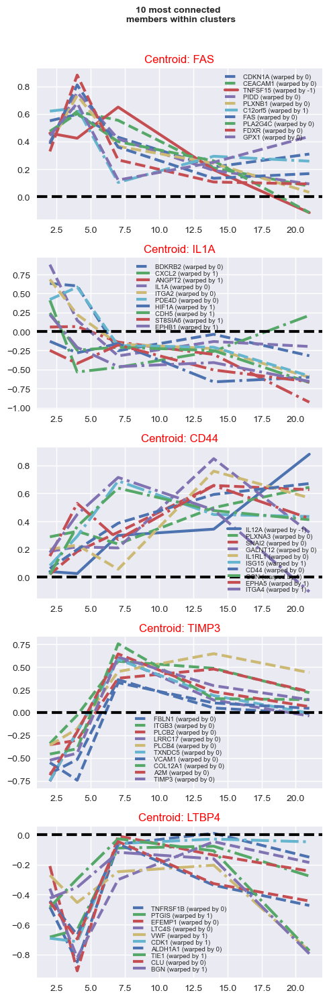

In [27]:
sparsity = 0.8
### Computing LINAC network (directed):
net_linac_dir = NetworkInference(data=linac_log2_data_doublenorm, var_names=gene_names_linac,
                                 time_points=time_pts, dist='d2hat', time_warp=True, 
                                 max_warp_step=max_warp_step, sign_pen=True, pen_param=pen_param_linac, 
                                 sparsity=sparsity, directed=True)     

### Plotting clusters' most connected components:
most_con_comp_linac = net_linac_dir.plot_most_connected_members(fc_clusters_linac_no, 
                                                                centroids=fc_centroids_linac_no,
                                                                warps=k_warps_linac,
                                                                nb_components=10, figsize=(5, 15))

Set `degree_view` to `True` for node sizes to reflect the degree:

MAN2A1 is missing
SERPINE1 is missing
CAP1 is missing


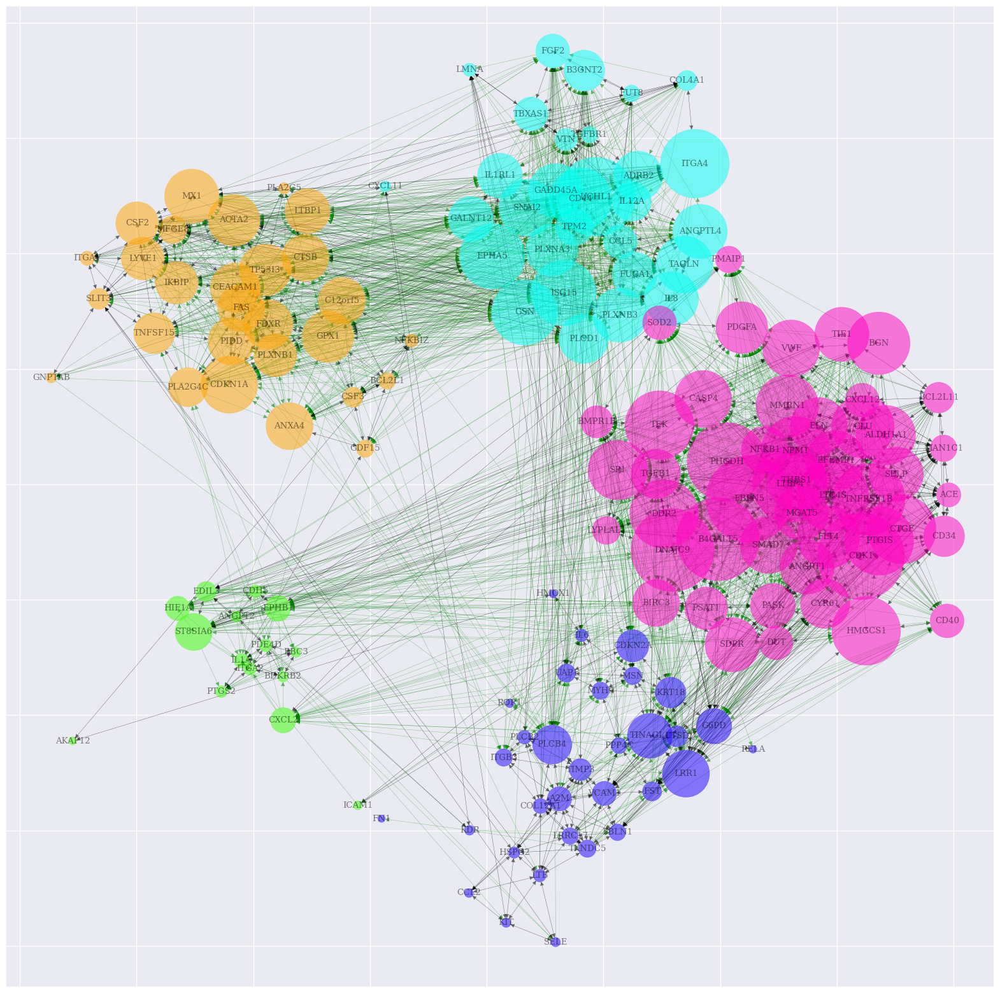

In [28]:
### Drawing full network (with degrees):       
net_linac_dir.compute_network(fc_clusters_linac_no, fc_centroids_linac_no, figsize=(20, 20), 
                              obj_scale=1.2, degree_view=True)

Various network analysis tools include degree distribution analysis, path search and vizualization:

/Users/apollinaria45/opt/anaconda3/envs/polinapy1/lib/python3.10/site-packages/networkx/algorithms/link_analysis/hits_alg.py:78: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  A = nx.adjacency_matrix(G, nodelist=list(G), dtype=float)


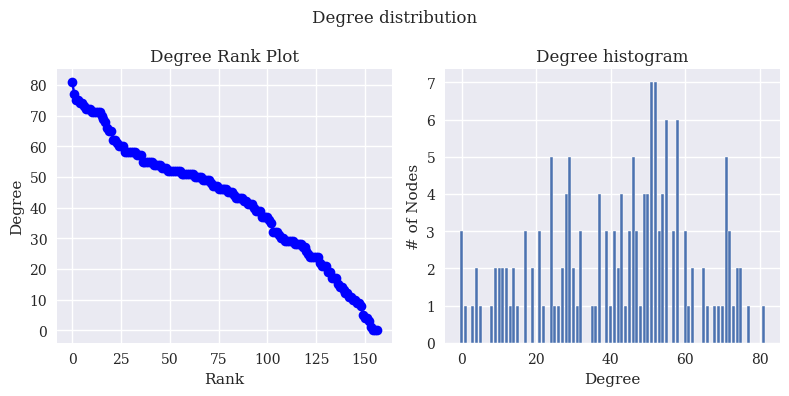

In [29]:
### Graph analysis
graph_analysis_linac = net_linac_dir.graph_analysis(fc_clusters_linac_no)

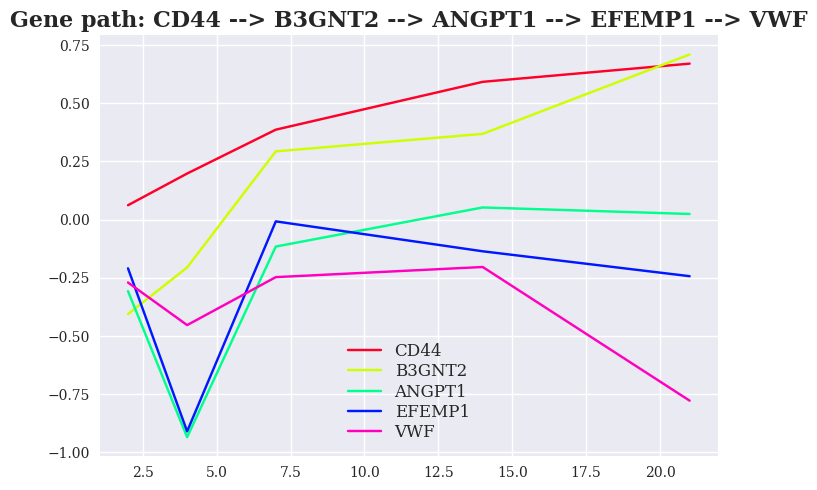

Gene path: CD44 --> B3GNT2 --> ANGPT1 --> EFEMP1 --> VWF
Warps:   1   1   0   0 


In [30]:
### Paths:
(path_linac,
 path_linac_warps) = net_linac_dir.compute_entity_path(entity_1='CD44', entity_2='VWF', figsize=(7,5))

In `pathway_search` paths are ranked by a score calculated based on the predictive nature of connections and change of cluster:

In [31]:
all_paths_linac = net_linac_dir.pathway_search(fc_clusters_linac_no)
all_paths_linac['5 paths'].head()

,0,1,2,3,4,5,Warp score,Cluster score,Total score
3312,CASP4,CDH5,BBC3,PLA2G4C,UCHL1,PLCB2,5,4,9
1351,ANGPTL4,ACTA2,PLCB4,KRT18,BIRC3,ICAM1,5,4,9
566,ADRB2,ACTA2,PLCB4,KRT18,BIRC3,ICAM1,5,4,9
589,ADRB2,ACTA2,PLCB4,KRT18,BIRC3,CDH5,5,4,9
10483,GNPTAB,FGF2,KRT18,BIRC3,HIF1A,EDIL3,5,4,9


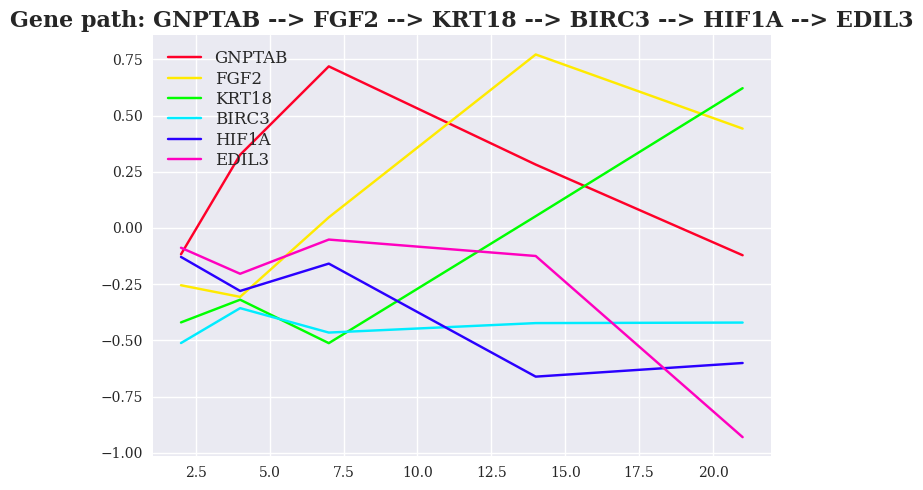

Gene path: GNPTAB --> FGF2 --> KRT18 --> BIRC3 --> HIF1A --> EDIL3
Warps:   1   1   1   1   1 


(array(['GNPTAB', 'FGF2', 'KRT18', 'BIRC3', 'HIF1A', 'EDIL3'], dtype='<U6'),
 [1, 1, 1, 1, 1])

In [32]:
path = all_paths_linac['5 paths'].iloc[4, :6].values.astype(str)
net_linac_dir.compute_entity_path(path_e1_to_e2=path, figsize=(7, 5))

A path can be visualized on the network (miscoscopic view) using parameters `draw_path` and `path`:

MAN2A1 is missing
SERPINE1 is missing
CAP1 is missing


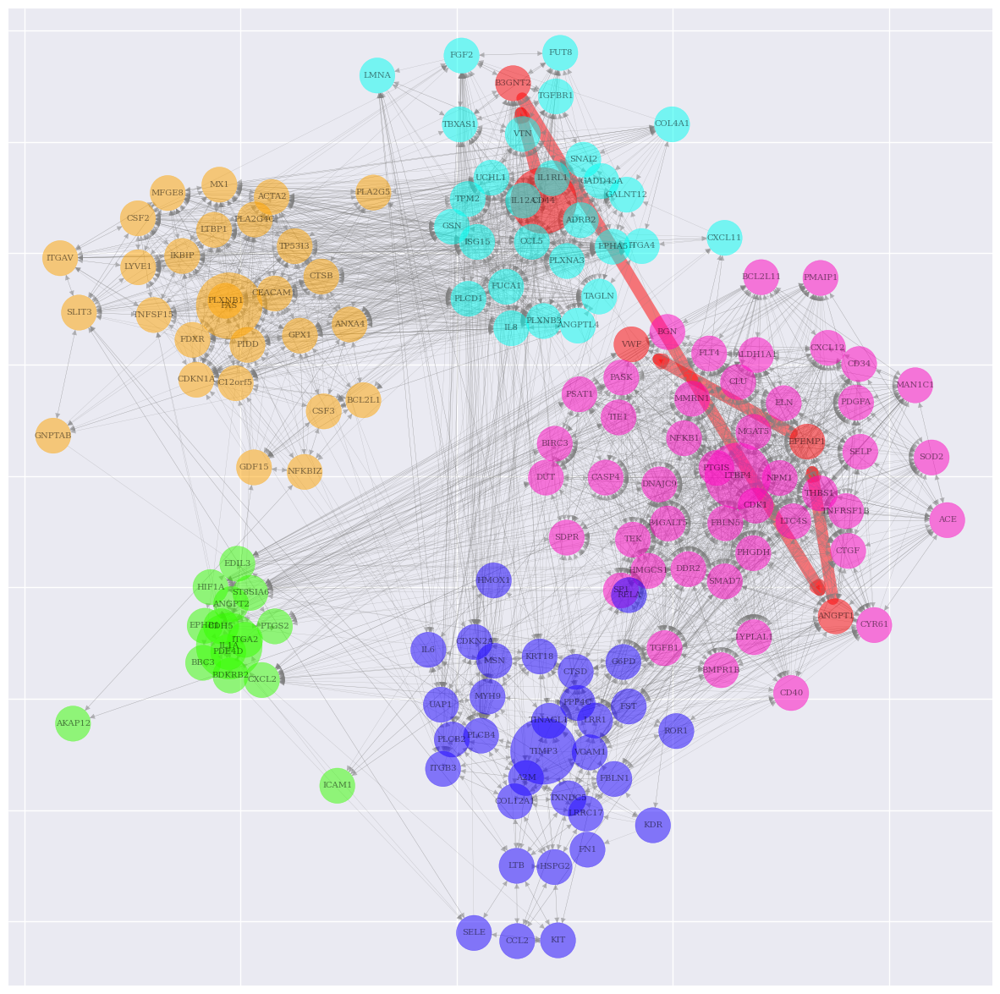

In [33]:
### Drawing full network with a path:       
net_linac_dir.compute_network(fc_clusters_linac_no, fc_centroids_linac_no, figsize=(15, 15), 
                              obj_scale=0.9, draw_path=True, path=path_linac)

A network in miscoscopic view can be drawn as full network, or only intersection or difference with another network, by manipulating the parameter `graph_type`:

BMPR1B is missing
CAP1 is missing


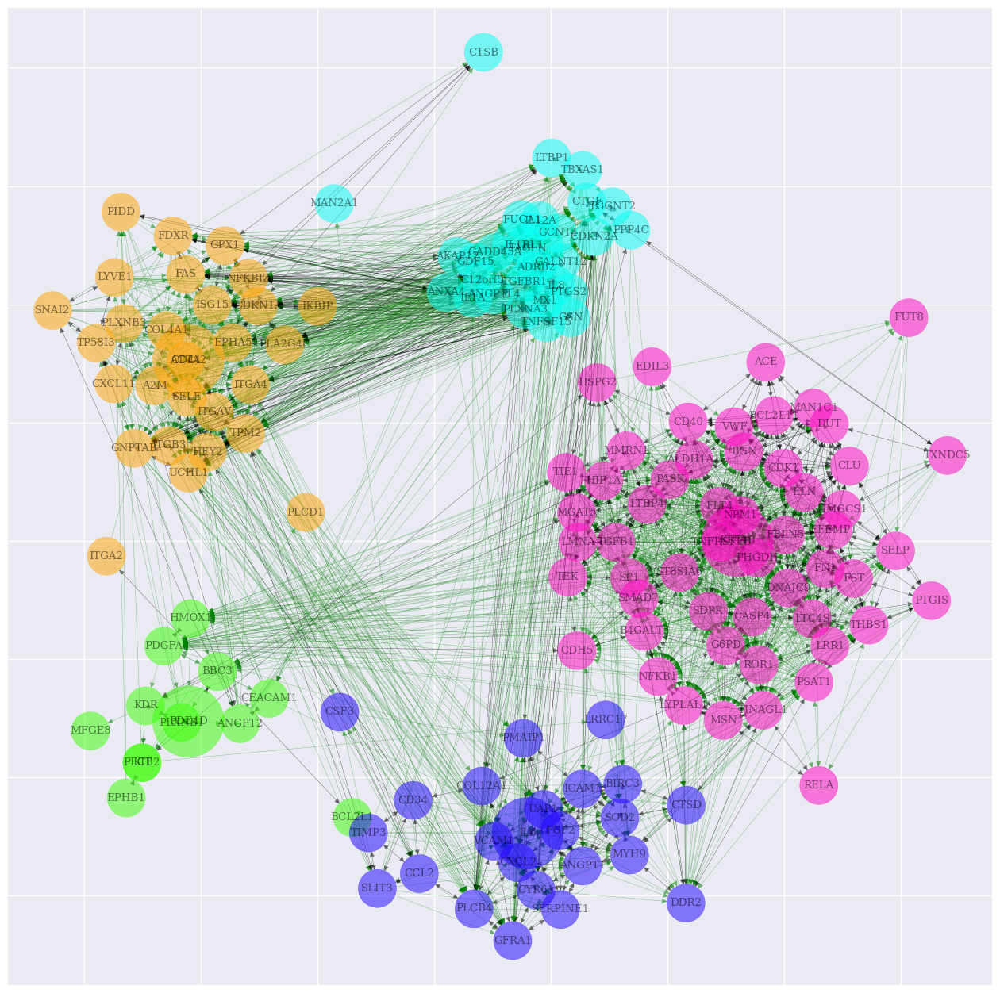

In [34]:
### Computing SARRP network (directed):
net_sarrp_dir = NetworkInference(data=sarrp_log2_data_doublenorm, var_names=gene_names_sarrp, 
                                 time_points=time_pts, dist='d2hat', time_warp=True,
                                 max_warp_step=max_warp_step, sign_pen=True, pen_param=pen_param_sarrp, 
                                 sparsity=sparsity, directed=True)     

### Drawing full network:       
net_sarrp_dir.compute_network(fc_clusters_sarrp_no, fc_centroids_sarrp_no, figsize=(16, 16), obj_scale=1.2)


IKBIP is missing
PIDD is missing
BBC3 is missing
BCL2L1 is missing
EPHB1 is missing
PLCB2 is missing
AKAP12 is missing
GADD45A is missing
IL12A is missing
MAN2A1 is missing
BMPR1B is missing
CAP1 is missing
CD34 is missing
CSF3 is missing
DDR2 is missing
ICAM1 is missing
LRRC17 is missing
SERPINE1 is missing
SOD2 is missing
CASP4 is missing
MMRN1 is missing
RELA is missing


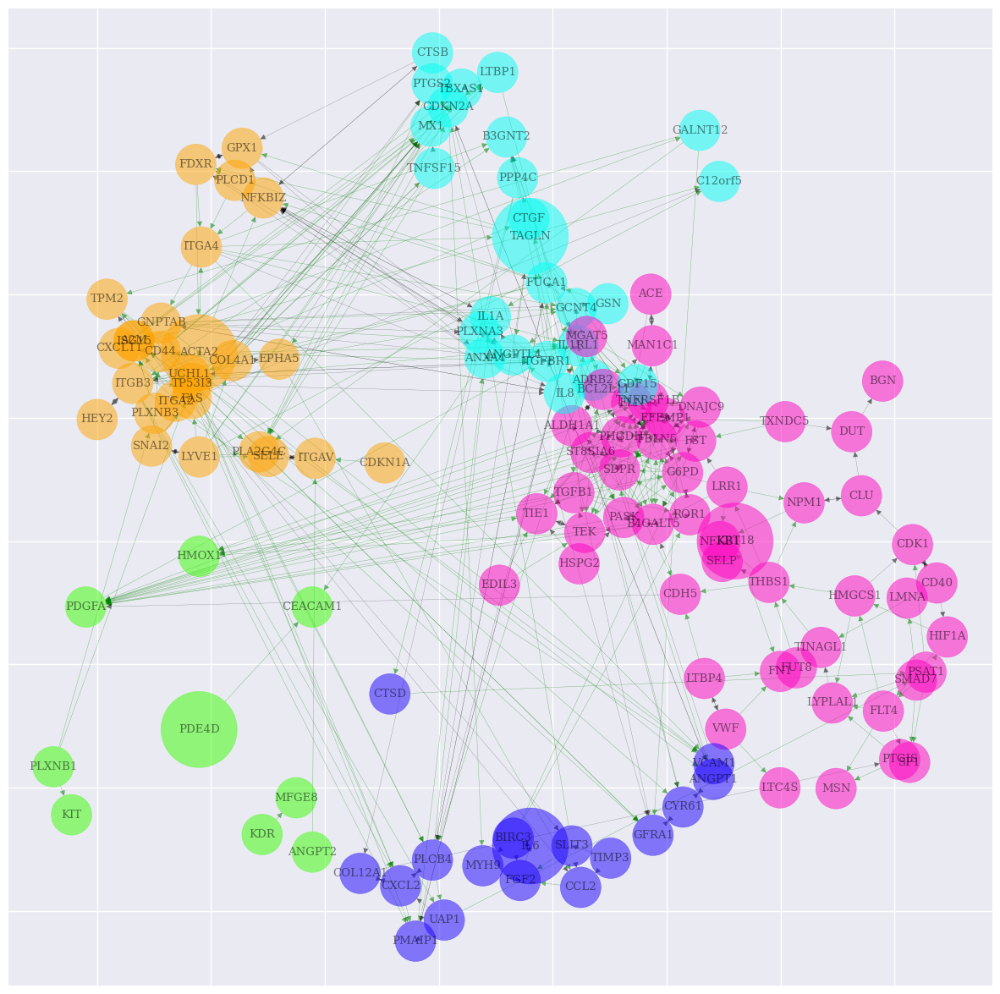

In [35]:
# Intersection:
net_sarrp_dir.compute_network(fc_clusters_sarrp_no, fc_centroids_sarrp_no, figsize=(15, 15), 
                              obj_scale=1.2, graph_type='intersection', adj_mat_2=net_linac_dir.adj_mat)

MFGE8 is missing
BMPR1B is missing
CAP1 is missing


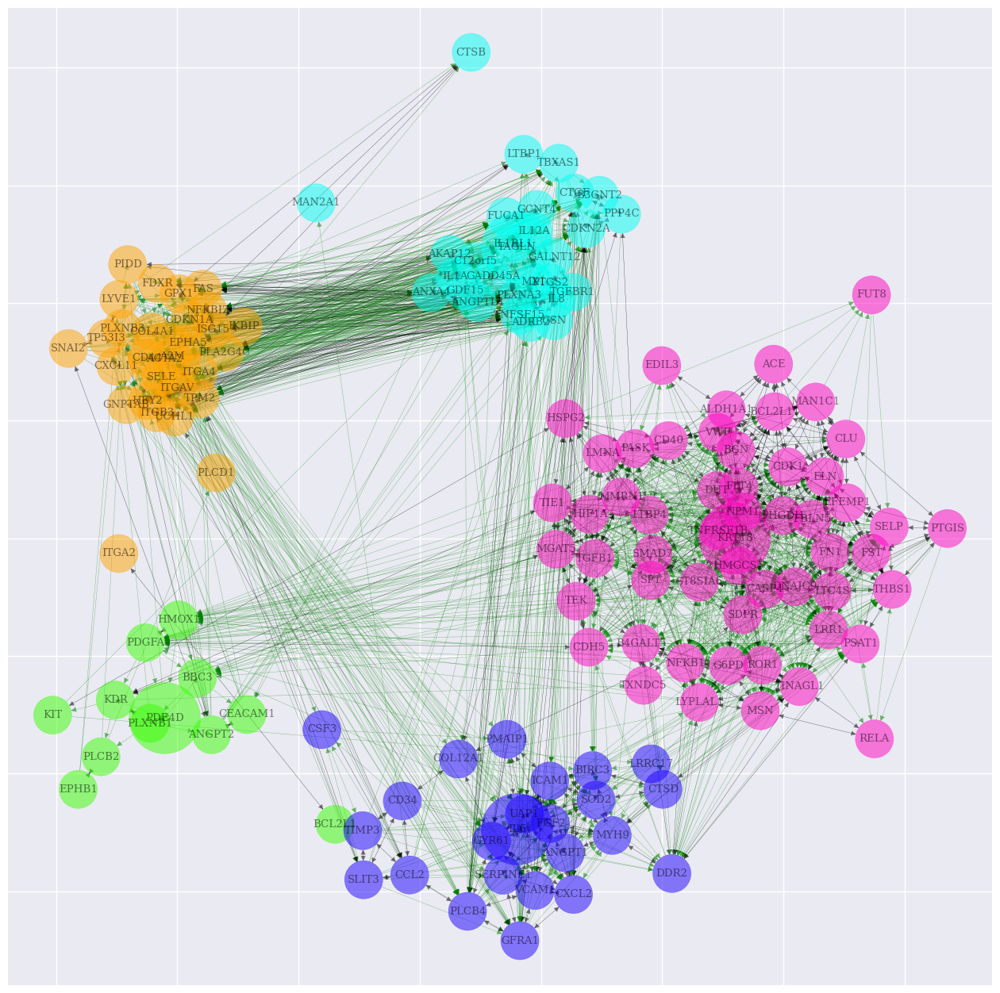

In [36]:
# Difference:
net_sarrp_dir.compute_network(fc_clusters_sarrp_no, fc_centroids_sarrp_no,
                              figsize=(16, 16), obj_scale=1.2, graph_type='difference', 
                              adj_mat_2=net_linac_dir.adj_mat)

Building mesoscopic network representations from condition-specific networks (keeping connections that only exist for the considered condition and not the other one):

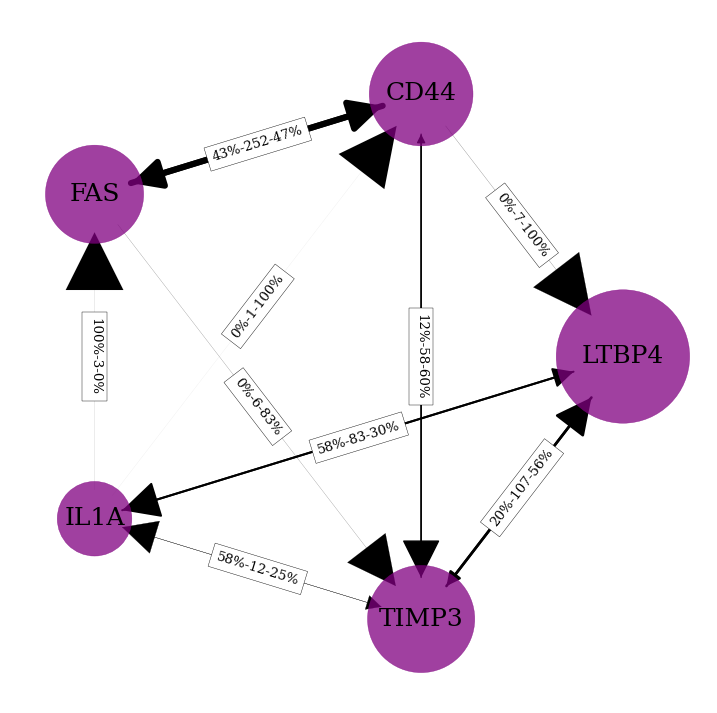

In [41]:
### LINAC specific network (common genes): 
# Creating the adjacency matrix: 
adj_mat_linac_common_genes = net_linac_dir.adj_mat[common_indices_linac,:][:, common_indices_linac]
adj_mat_sarrp_common_genes = net_sarrp_dir.adj_mat[common_indices_sarrp,:][:, common_indices_sarrp] 
adj_mat_linac = net_linac_dir.adj_mat
adj_mat_sarrp_expanded = np.zeros((nb_var_linac, nb_var_linac))
adj_mat_sarrp_expanded[tuple(np.meshgrid(common_indices_linac, 
                                         common_indices_linac))] = adj_mat_sarrp_common_genes.T
adj_mat_linac_sp = adj_mat_linac - adj_mat_sarrp_expanded
adj_mat_linac_sp[adj_mat_linac_sp < 0] = 0

linac_log2_data_doublenorm_common = linac_log2_data_doublenorm[:, :, :, common_indices_linac]
adj_mat_linac_sp_common = adj_mat_linac_sp[common_indices_linac, :][:, common_indices_linac]

# Building the network: 
net_linac_sp_common = NetworkInference(data=linac_log2_data_doublenorm_common, adj_mat=adj_mat_linac_sp_common, 
                                       var_names=common_genes, time_points=time_pts, dist='d2hat', 
                                       time_warp=True, max_warp_step=max_warp_step, sign_pen=True,
                                       pen_param=pen_param_linac, sparsity=sparsity, directed=True) 
fc_centroids_linac_common = [(common_indices_linac==c).nonzero()[0][0] for c in fc_centroids_linac_no]
net_linac_sp_common.draw_mesoscopic(fc_clusters_linac_no[common_indices_linac], fc_centroids_linac_common, 
                                    obj_scale=0.8, figsize=(9, 9), node_label_size=18)

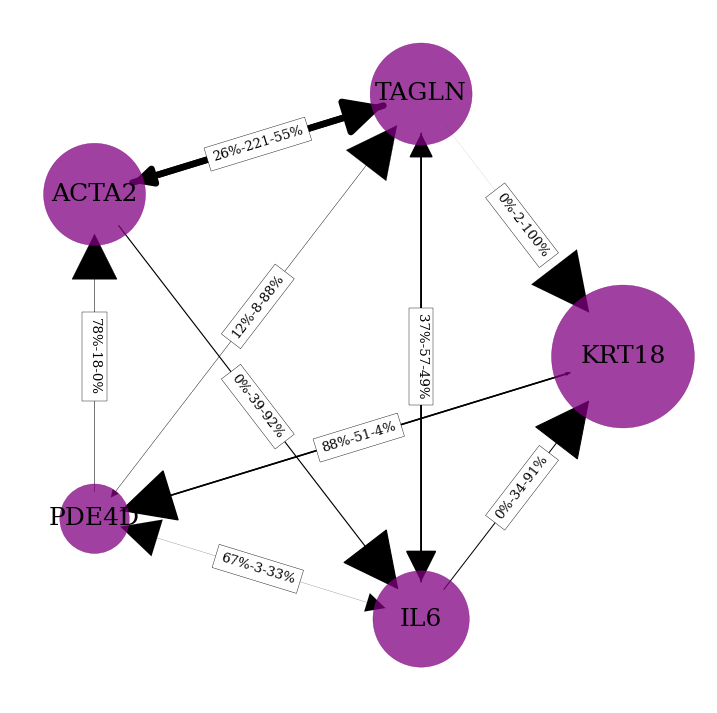

In [42]:
### SARRP specific network (common genes):
# Creating the adjacency matrix: 
adj_mat_linac_expanded = np.zeros((nb_var_sarrp, nb_var_sarrp))
adj_mat_linac_expanded[tuple(np.meshgrid(common_indices_sarrp, 
                                         common_indices_sarrp))] = adj_mat_linac_common_genes.T
adj_mat_sarrp = net_sarrp_dir.adj_mat
adj_mat_sarrp_sp = adj_mat_sarrp - adj_mat_linac_expanded
adj_mat_sarrp_sp[adj_mat_sarrp_sp < 0] = 0

sarrp_log2_data_doublenorm_common = sarrp_log2_data_doublenorm[:, :, :, common_indices_sarrp]
adj_mat_sarrp_sp_common = adj_mat_sarrp_sp[common_indices_sarrp, :][:, common_indices_sarrp]

# Building the network: 
net_sarrp_sp_common = NetworkInference(data=sarrp_log2_data_doublenorm_common, adj_mat=adj_mat_sarrp_sp_common, 
                                       var_names=common_genes, time_points=time_pts, dist='d2hat', 
                                       time_warp=True, max_warp_step=max_warp_step, sign_pen=True,
                                       pen_param=pen_param_sarrp, sparsity=sparsity, directed=True) 
fc_centroids_sarrp_common = [(common_indices_sarrp==c).nonzero()[0][0] for c in fc_centroids_sarrp_no]

net_sarrp_sp_common.draw_mesoscopic(fc_clusters_sarrp_no[common_indices_sarrp], fc_centroids_sarrp_common, 
                                    obj_scale=0.8, figsize=(9, 9), node_label_size=18)

Building a hybrid network representation (LINAC clusters on SARRP-specific network) to better understand changes in network distribution:

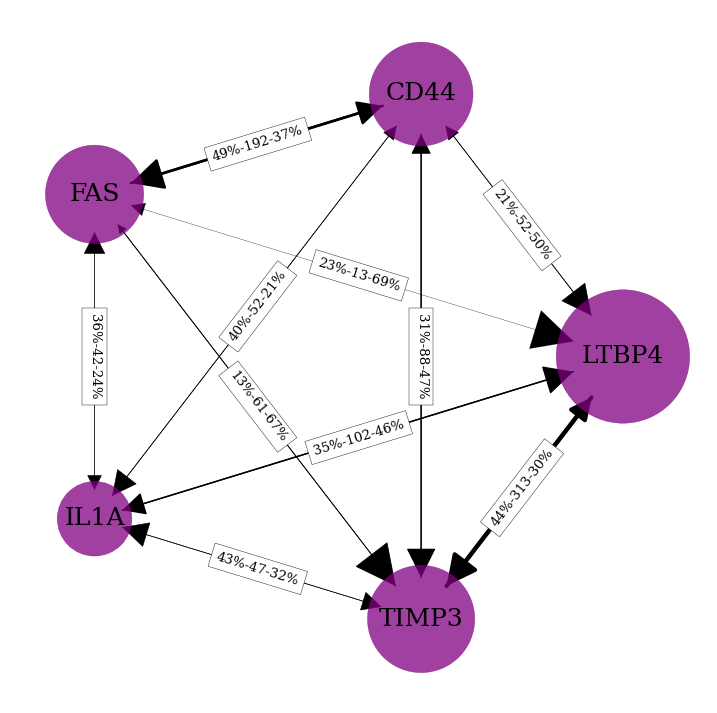

In [43]:
# LINAC clusters on SARRP network:
net_sarrp_sp_common.draw_mesoscopic(fc_clusters_linac_no[common_indices_linac], fc_centroids_linac_common, 
                                    obj_scale=0.8, figsize=(9, 9), node_label_size=18)

We can create a graph intersection network and visualize clusterings in order to compare the two condidions:

BCL2L1 is missing
CSF3 is missing
MFGE8 is missing
EPHB1 is missing
ITGA2 is missing
MAN2A1 is missing
FUT8 is missing
SERPINE1 is missing
CAP1 is missing
CCL2 is missing
FN1 is missing
HMOX1 is missing
PLCB2 is missing
RELA is missing
BMPR1B is missing
PMAIP1 is missing


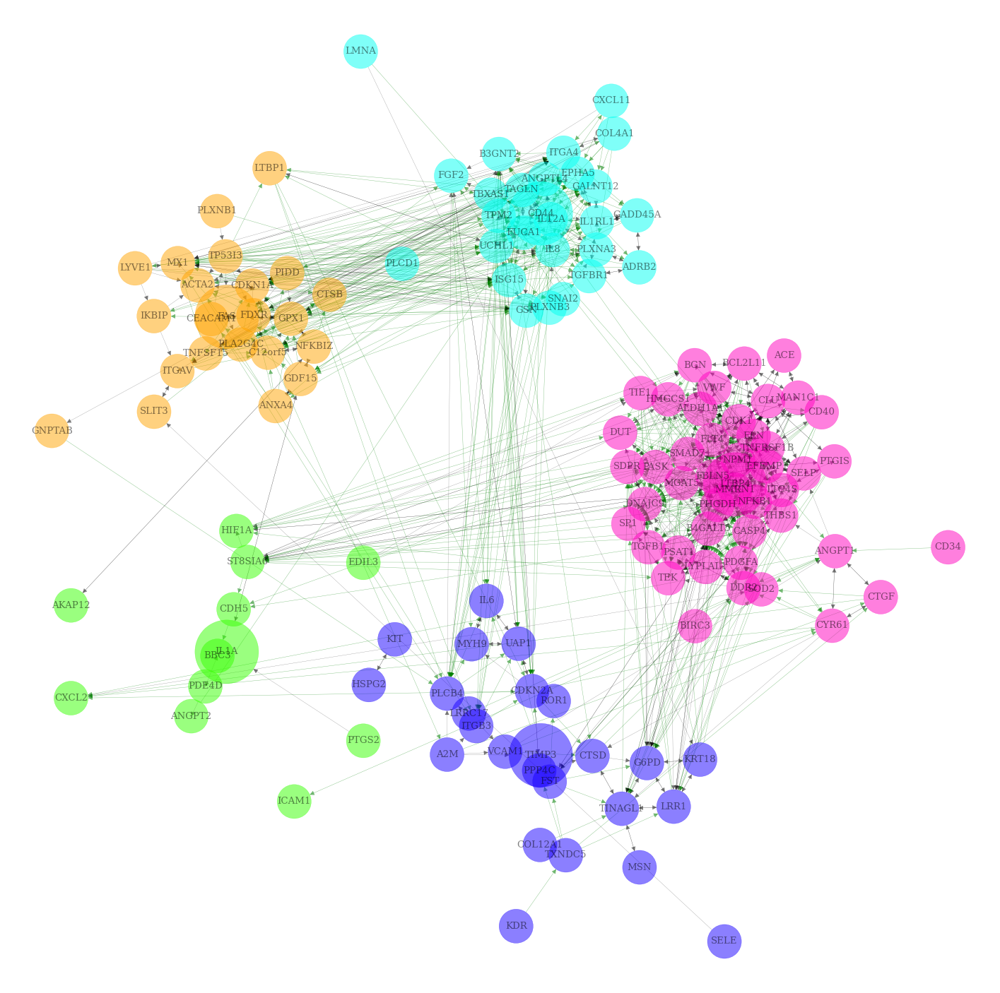

In [48]:
### Condition intersection graphs:
net_linac_common_genes = NetworkInference(data=linac_log2_data_doublenorm, adj_mat=adj_mat_linac_common_genes, 
                                            var_names=common_genes, time_points=time_pts, dist='d2hat', 
                                time_warp=True, max_warp_step=max_warp_step, sign_pen=True,
                                pen_param=pen_param_linac, sparsity=sparsity, directed=True)
net_linac_common_genes.compute_network(fc_clusters_linac_no[common_indices_linac], 
                             fc_centroids_linac_common, figsize=(18, 18), obj_scale=1.2,
                             graph_type='intersection', adj_mat_2=adj_mat_sarrp_common_genes)

We can use parameters `clusters_2` and `centroids_2` to color the nodes on the LINAC network with respect to the SARRP clustering:

BCL2L1 is missing
CSF3 is missing
MFGE8 is missing
EPHB1 is missing
ITGA2 is missing
MAN2A1 is missing
FUT8 is missing
SERPINE1 is missing
CAP1 is missing
CCL2 is missing
FN1 is missing
HMOX1 is missing
PLCB2 is missing
RELA is missing
BMPR1B is missing
PMAIP1 is missing


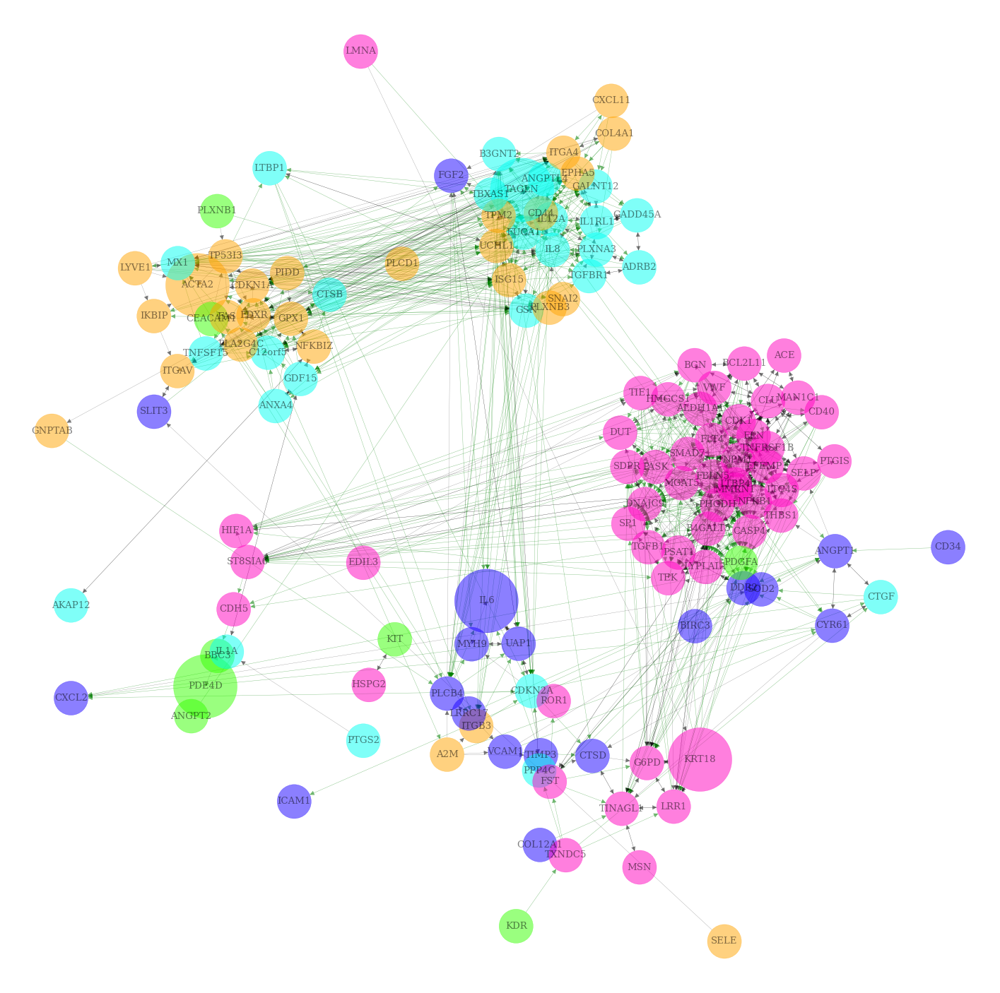

In [49]:
net_linac_common_genes.compute_network(fc_clusters_linac_no[common_indices_linac], 
                                       fc_centroids_linac_common, 
                                       clusters_2=fc_clusters_sarrp_no[common_indices_sarrp],
                                       centroids_2=fc_centroids_sarrp_common, figsize=(18, 18), obj_scale=1.2,
                                       graph_type='intersection', adj_mat_2=adj_mat_sarrp_common_genes)